<a href="https://colab.research.google.com/github/Uyen02122003/Python-2/blob/main/T2_2025_MIS780_A1_Template.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## MIS780 Advanced AI For Business - Assessment 1 - T2 2025

**Student Name:** _enter your full name here_

**Student ID:** _enter your student ID here_

## Table of Content

1. [Executive Summary](#cell_executivesummary)


2. [Data Exploration](#cell_exploration)


3. [Sentiment Analysis](#cell_sentiment)


4. [Topic Modeling](#cell_TopicModeling)


5. [Practical Implication](#cell_PracticalImplication)


<a id = "cell_executivesummary"></a>
### 1. Executive Summary


#### NOTE: all the instructions and hints given in this template should be removed from your final submission. (Including this line)
**Aim:** To clearly articulate your understanding of the bussiness problem to management.

_Define your problem in business term. What is the aim of this project? What benefit will it generate to the business and its customers?_

_Present your proposed approaches._

_Present your major findings and explain how they help to address the business problem. Cross-reference with other report sections for support. Do not include chart or tables in this section._

<a id = "cell_exploration"></a>
### 2. Data Exploration

#### NOTE: You can create multiple Markdown and Code cells to present your work.
**Aim:** To demonstrate your understanding of data and report any insights emerging from data analysis

_Process and explore the characteristics of the attributes the provided data set._

_Use table or figure to support answering questions (A) and (B)_


<a id = "cell_LDA"></a>
Text Preprocessing

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# code cell
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/MIS780/Assignment 1/A1_dataset.csv")
df.head()

,AirlineName,CabinType,DateFlown,EntertainmentRating,FoodRating,GroundServiceRating,OriginCountry,OverallScore,Recommended,Review,SeatComfortRating,ServiceRating,Title,TravelType,ValueRating,WifiRating,unique_id
0,Aeroflot Russian Airlines,Economy Class,Jan-23,0,0,0,Greece,1,no,I had booked a flight from Greece to Cuba. Due...,0,0,travel to Russia to receive my refund,Solo Leisure,1,0,1
1,Aeroflot Russian Airlines,Economy Class,Jul-22,0,0,0,Ireland,1,no,Has your flight been cancelled by Aeroflot the...,0,0,waiting for a refund for last 2.5 years,Solo Leisure,1,0,2
2,Aeroflot Russian Airlines,Business Class,Jan-22,5,4,2,UnitedKingdom,5,no,Aeroflot has set high standards of achieving a...,5,2,felt very rushed and unpolished,Solo Leisure,2,3,3
3,Aeroflot Russian Airlines,Economy Class,Aug-21,0,5,5,RussianFederation,10,yes,"Best airline in Russia! Very nice staff, comfo...",5,5,Best airline in Russia,Business,5,5,4
4,Aeroflot Russian Airlines,Business Class,Sep-21,4,4,5,UnitedKingdom,10,yes,I was very impressed with the staff. Many than...,4,5,cabin crew were outstanding,Business,4,0,5


In [ ]:
# Once you have imported the original dataset (74000 reviews), save it to a dataframe (e.g. "df"). Then, use the following code snippet to take a random sample of 50000 reviews based on your student ID (e.g. "sample_df").
# Uncomment the below two lines and adjust the variable names of your choice.

seed = 224705349
sample_df = df.sample(n=50000, random_state=seed)

# Your entire analysis should be based on this unique 50000 airline review sample.

In [ ]:
sample_df = sample_df[~sample_df['Review'].isnull()]

# Define a function to clean text
def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace(r'(<br/>)', ' ', regex=True)
    ReviewText = ReviewText.str.replace(r'(<a).*(>).*(</a>)', ' ', regex=True)
    ReviewText = ReviewText.str.replace(r'(&amp)', 'and', regex=True)
    ReviewText = ReviewText.str.replace(r'(&gt)|(&lt)', ' ', regex=True)
    ReviewText = ReviewText.str.replace(r'(\xa0)', ' ', regex=True)
    ReviewText = ReviewText.str.lower()                            # Lowercase
    ReviewText = ReviewText.str.replace(r'\d+', '', regex=True)    # Remove numbers
    ReviewText = ReviewText.str.replace(r'[^\w\s]', '', regex=True) # Remove punctuation
    ReviewText = ReviewText.str.replace(r'\s+', ' ', regex=True)   # Normalize whitespace
    ReviewText = ReviewText.str.strip()                            # Remove leading/trailing whitespace
    return ReviewText

# Apply cleaning
sample_df['Review'] = preprocess(sample_df['Review'])

# Create new features
sample_df['review_len'] = sample_df['Review'].astype(str).apply(len)
sample_df['word_count'] = sample_df['Review'].apply(lambda x: len(str(x).split()))

# Format DateFlown column
sample_df['DateFlown'] = pd.to_datetime(sample_df['DateFlown'], format='%b-%y')
sample_df = sample_df.sort_values('DateFlown')
sample_df.head()


,AirlineName,CabinType,DateFlown,EntertainmentRating,FoodRating,GroundServiceRating,OriginCountry,OverallScore,Recommended,Review,SeatComfortRating,ServiceRating,Title,TravelType,ValueRating,WifiRating,unique_id,review_len,word_count
53443,Singapore Airlines,Economy Class,2013-03-01,3,5,5,Switzerland,10,yes,zürich to singapore in march as i do my bookin...,5,5,all three seats were free,Solo Leisure,5,0,53444,467,89
53444,Singapore Airlines,Economy Class,2013-04-01,3,5,5,Switzerland,10,yes,singapore to zurich in may in april to my know...,4,5,there is a lot of legroom,Couple Leisure,5,0,53445,519,100
44573,Lufthansa,Business Class,2014-07-01,3,4,4,Canada,7,yes,overall rating of the lufthansa business class...,5,3,Lufthansa customer review,Business,1,2,44574,305,49
1807,Aeroflot Russian Airlines,Economy Class,2014-07-01,2,4,3,UnitedStates,7,yes,good value for money although aircraft itself ...,1,5,Aeroflot Russian Airlines customer review,Family Leisure,4,1,1808,115,21
15616,American Airlines,Economy Class,2014-07-01,0,0,1,Chile,3,no,the seats were uncomfortable service was a str...,2,1,American Airlines customer review,Family Leisure,2,0,15617,293,54


In [ ]:
sample_df.describe()

,DateFlown,EntertainmentRating,FoodRating,GroundServiceRating,OverallScore,SeatComfortRating,ServiceRating,ValueRating,WifiRating,unique_id,review_len,word_count
count,50000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,2018-12-31 17:12:58.176000512,1.514480,1.878440,2.313140,3.912140,2.426260,2.669160,2.442360,0.667160,36925.066060,772.414940,143.315000
min,2013-03-01 00:00:00,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,69.000000,12.000000
25%,2017-02-01 00:00:00,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,18331.500000,397.000000,72.000000
50%,2018-11-01 00:00:00,1.000000,1.000000,1.000000,2.000000,2.000000,3.000000,2.000000,0.000000,36926.500000,616.000000,113.000000
75%,2020-11-01 00:00:00,3.000000,3.000000,4.000000,7.000000,4.000000,4.000000,4.000000,1.000000,55520.500000,972.000000,181.000000
max,2023-05-01 00:00:00,5.000000,5.000000,5.000000,10.000000,5.000000,5.000000,5.000000,5.000000,73999.000000,5335.000000,1025.000000
std,NaN,1.733485,1.743056,1.626572,3.411031,1.546664,1.709586,1.589757,1.246503,21422.592713,545.341652,103.025679


In [ ]:
sample_df.shape
sample_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50000 entries, 53443 to 17218
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   AirlineName          50000 non-null  object        
 1   CabinType            50000 non-null  object        
 2   DateFlown            50000 non-null  datetime64[ns]
 3   EntertainmentRating  50000 non-null  int64         
 4   FoodRating           50000 non-null  int64         
 5   GroundServiceRating  50000 non-null  int64         
 6   OriginCountry        50000 non-null  object        
 7   OverallScore         50000 non-null  int64         
 8   Recommended          50000 non-null  object        
 9   Review               50000 non-null  object        
 10  SeatComfortRating    50000 non-null  int64         
 11  ServiceRating        50000 non-null  int64         
 12  Title                50000 non-null  object        
 13  TravelType           50000 non-n

In [ ]:
sample_df.isnull().sum()

,0
AirlineName,0
CabinType,0
DateFlown,0
EntertainmentRating,0
FoodRating,0
GroundServiceRating,0
OriginCountry,0
OverallScore,0
Recommended,0
Review,0


A. Top 10 overall Rating across various cabin types

- Do this airlines consistenly rank in the top 10 for entertainment, food and ground service
- Does "Quantas Airways" or "Jestar Airways" appear in any of above the top 10 lists
- Whether Quantas or Jestar is one of the most recommend (top 10) or the least recommend for anycabin type


In [ ]:
from matplotlib import pyplot

1. Top 10 Overall Rating across cabin types

=> Use Overall score for this one

Top 10 Airlines by Overall Rating (All Cabin Types, ≥100 Reviews):
AirlineName
Hainan Airlines            8.829903
China Southern Airlines    8.137587
ANA All Nippon Airways     8.030136
Garuda Indonesia           7.892123
Vistara                    7.770724
EVA Air                    7.763555
Qatar Airways              7.468679
Japan Airlines             7.248264
Thai Smile Airways         7.225490
Aegean Airlines            7.225059
Name: OverallScore, dtype: float64

Bottom 10 Airlines by Overall Rating (All Cabin Types, ≥100 Reviews):
AirlineName
Volaris                 1.331818
Frontier Airlines       1.413036
Silver Airways          1.539823
Spirit Airlines         1.543288
Allegiant Air           1.726090
Wizz Air                2.099768
WOW air                 2.110360
Sun Country Airlines    2.270968
VietJet Air             2.295058
AirAsia                 2.412533
Name: OverallScore, dtype: float64


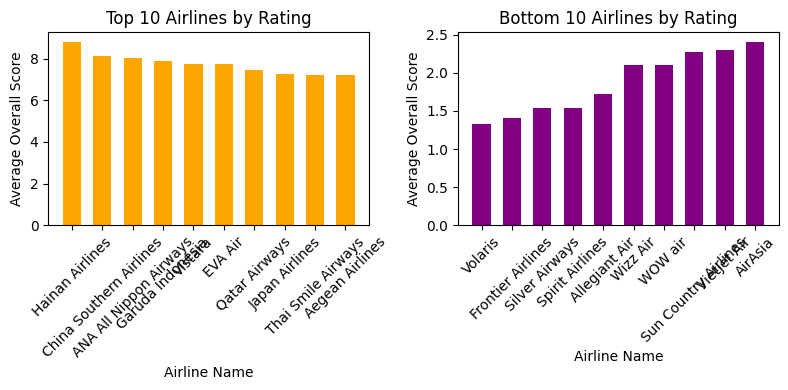

In [ ]:
# Count total reviews per airline
review_counts = sample_df.groupby('AirlineName')['unique_id'].nunique().reset_index(name='TotalReviews')
eligible_airlines = review_counts[review_counts['TotalReviews'] >= 100]['AirlineName']

# Filter original DataFrame to only those airlines
filtered_df = sample_df[sample_df['AirlineName'].isin(eligible_airlines)]

# Group by Airline and CabinType, compute mean rating
cabin_rating = filtered_df.groupby(['AirlineName', 'CabinType'])['OverallScore'].mean().reset_index()

# Average across all cabin types per airline
overall_avg = cabin_rating.groupby('AirlineName')['OverallScore'].mean()

# Get top and bottom 10
top10 = overall_avg.sort_values(ascending=False).head(10)
bottom10 = overall_avg.sort_values().head(10)

# Print top 10 airlines
print("Top 10 Airlines by Overall Rating (All Cabin Types, ≥100 Reviews):")
print(top10)

# Print bottom 10 airlines
print("\nBottom 10 Airlines by Overall Rating (All Cabin Types, ≥100 Reviews):")
print(bottom10)

# Plotting
pyplot.figure(figsize=(8, 4))

# Top 10 plot
pyplot.subplot(1, 2, 1)
pyplot.bar(top10.index, top10.values, color='orange', width=0.6)
pyplot.title('Top 10 Airlines by Rating')
pyplot.xlabel('Airline Name')
pyplot.ylabel('Average Overall Score')
pyplot.xticks(rotation=45)

# Bottom 10 plot
pyplot.subplot(1, 2, 2)
pyplot.bar(bottom10.index, bottom10.values, color='purple', width=0.6)
pyplot.title('Bottom 10 Airlines by Rating')
pyplot.xlabel('Airline Name')
pyplot.ylabel('Average Overall Score')
pyplot.xticks(rotation=45)

pyplot.tight_layout()
pyplot.show()


2. Do these airlines
consistently rank in the top 10 for entertainment, food and ground services as well?

Top 10 Airlines by Entertainment Rating (All Cabin Types):
AirlineName
Hainan Airlines            3.837450
Qatar Airways              3.689484
Emirates                   3.624900
Cathay Pacific Airways     3.604862
Singapore Airlines         3.602859
EVA Air                    3.490986
China Southern Airlines    3.411814
ANA All Nippon Airways     3.300291
Japan Airlines             3.112847
China Airlines             3.046218
Name: EntertainmentRating, dtype: float64

Top 10 Airlines by Food Rating (All Cabin Types):
AirlineName
Hainan Airlines            4.406575
China Southern Airlines    3.975476
Garuda Indonesia           3.887908
EVA Air                    3.884348
ANA All Nippon Airways     3.853101
Qatar Airways              3.844922
Vistara                    3.800597
Air Astana                 3.735209
Bangkok Airways            3.701977
Japan Airlines             3.689236
Name: FoodRating, dtype: float64

Top 10 Airlines by Ground Service Rating (All Cabin Types):
AirlineNam

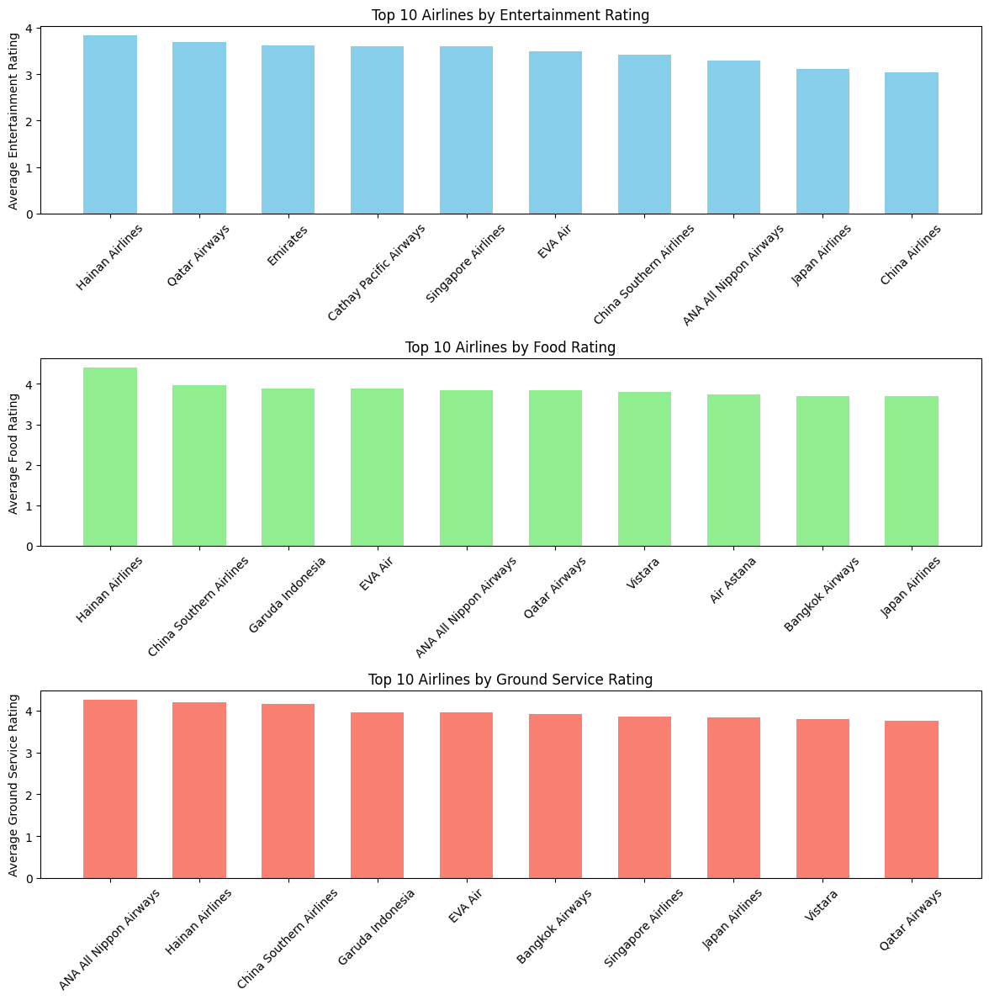

In [ ]:
# Group by Airline and CabinType, compute mean for each service metric
cabin_service = sample_df.groupby(['AirlineName', 'CabinType'])[
    ['EntertainmentRating', 'FoodRating', 'GroundServiceRating']
].mean().reset_index()

# Average across all cabin types per airline
service_avg = cabin_service.groupby('AirlineName')[[
    'EntertainmentRating', 'FoodRating', 'GroundServiceRating'
]].mean()

# Get top 10 airlines for each metric
top10_entertainment = service_avg['EntertainmentRating'].sort_values(ascending=False).head(10)
top10_food = service_avg['FoodRating'].sort_values(ascending=False).head(10)
top10_ground = service_avg['GroundServiceRating'].sort_values(ascending=False).head(10)

# Print Top 10s
print("Top 10 Airlines by Entertainment Rating (All Cabin Types):")
print(top10_entertainment)

print("\nTop 10 Airlines by Food Rating (All Cabin Types):")
print(top10_food)

print("\nTop 10 Airlines by Ground Service Rating (All Cabin Types):")
print(top10_ground)

# Plot all three
pyplot.figure(figsize=(12, 12))

# Entertainment
pyplot.subplot(3, 1, 1)
pyplot.bar(top10_entertainment.index, top10_entertainment.values, color='skyblue', width=0.6)
pyplot.title('Top 10 Airlines by Entertainment Rating')
pyplot.ylabel('Average Entertainment Rating')
pyplot.xticks(rotation=45)

# Food
pyplot.subplot(3, 1, 2)
pyplot.bar(top10_food.index, top10_food.values, color='lightgreen', width=0.6)
pyplot.title('Top 10 Airlines by Food Rating')
pyplot.ylabel('Average Food Rating')
pyplot.xticks(rotation=45)

# Ground Service
pyplot.subplot(3, 1, 3)
pyplot.bar(top10_ground.index, top10_ground.values, color='salmon', width=0.6)
pyplot.title('Top 10 Airlines by Ground Service Rating')
pyplot.ylabel('Average Ground Service Rating')
pyplot.xticks(rotation=45)

pyplot.tight_layout()
pyplot.show()

Add code for data exploration
-

3. Does “Qantas Airways” or “Jetstar
Airways” appear in any of the above top 10 lists?

=> No

4. Additionally, your client would like to know whether
“Qantas Airways” or “Jetstar Airways” is one of the most recommended (top 10) or the least
recommended (bottom 10) airlines for any cabin type

In [ ]:
# Loop through each cabin type
for cabin in sample_df['CabinType'].unique():
    print(f"\n📘 Cabin Type: {cabin}")

    # Filter data for the current cabin
    cabin_df = sample_df[sample_df['CabinType'] == cabin]

    #Total reviews per airline
    total_reviews = cabin_df.groupby('AirlineName')['unique_id'].nunique().reset_index(name='TotalReviews')

    #"yes" recommendations per airline
    yes_reviews = cabin_df[cabin_df['Recommended'] == 'yes'].groupby('AirlineName')['unique_id'].nunique().reset_index(name='YesCount')

    # Merge both tables
    summary = pd.merge(total_reviews, yes_reviews, on='AirlineName', how='left')
    summary['YesCount'] = summary['YesCount'].fillna(0).astype(int)
    summary['RecommendRate (%)'] = (summary['YesCount'] / summary['TotalReviews']) * 100

    #Filter airlines with at least 100 total reviews
    summary_filtered = summary[summary['TotalReviews'] >= 100]

    # Sort and get top/bottom 10
    top10 = summary_filtered.sort_values(by='RecommendRate (%)', ascending=False).head(10)
    bottom10 = summary_filtered.sort_values(by='RecommendRate (%)', ascending=True).head(10)

    # Print results
    print("\n Top 10 Airlines by Recommend Percentage (≥100 Reviews):")
    print(top10[['AirlineName', 'TotalReviews', 'YesCount', 'RecommendRate (%)']])

    print("\n Bottom 10 Airlines by Recommend Percentage (≥100 Reviews):")
    print(bottom10[['AirlineName', 'TotalReviews', 'YesCount', 'RecommendRate (%)']])



📘 Cabin Type: Economy Class

 Top 10 Airlines by Recommend Percentage (≥100 Reviews):
                 AirlineName  TotalReviews  YesCount  RecommendRate (%)
53           Hainan Airlines           159       142          89.308176
34   China Southern Airlines           695       612          88.057554
0     ANA All Nippon Airways           129       111          86.046512
50          Garuda Indonesia           219       177          80.821918
106                  Vistara           103        77          74.757282
25           Bangkok Airways           118        88          74.576271
96        Thai Smile Airways           153       112          73.202614
77             Qatar Airways           728       531          72.939560
63                Korean Air           125        90          72.000000
38                   EVA Air           117        83          70.940171

 Bottom 10 Airlines by Recommend Percentage (≥100 Reviews):
              AirlineName  TotalReviews  YesCount  Recommend

B. How have overall passenger ratings for “Qantas Airways” changed over time compared to the top 5
rated airlines? Are there any noticeable trends or patterns in the variation of overall ratings over time
for “Qantas Airways” and the other top five-rated airlines? Discuss any possible factors that may have
influenced the above trends

1. How have overall passenger ratings for “Qantas Airways” changed over time compared to the top 5 rated airlines?

/tmp/ipython-input-301533416.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trend_df = sample_df[df['AirlineName'].isin(selected_airlines)]


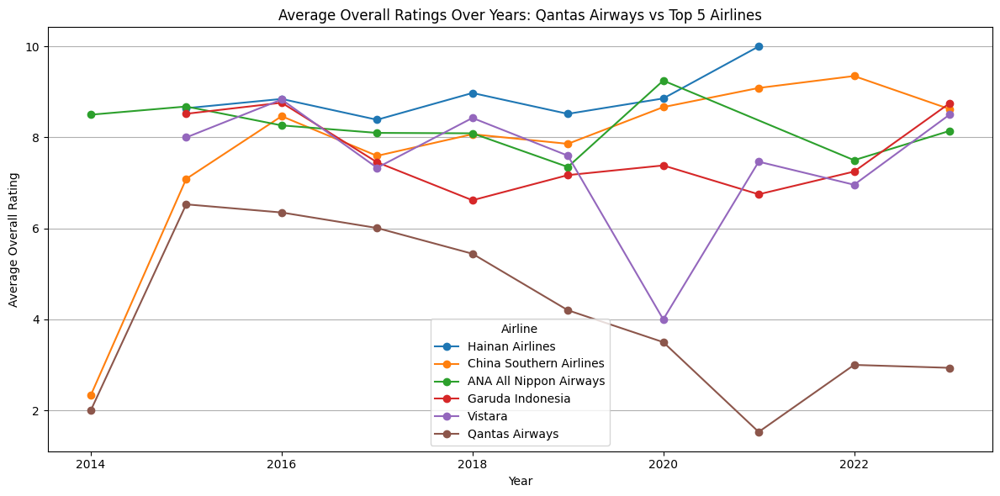

In [ ]:
cabin_rating = filtered_df.groupby(['AirlineName', 'CabinType'])['OverallScore'].mean().reset_index()
overall_avg = cabin_rating.groupby('AirlineName')['OverallScore'].mean().sort_values(ascending=False)

#Top 5 airlines by average rating (excluding Qantas)
top5_airlines = overall_avg.drop('Qantas Airways', errors='ignore').head(5).index.tolist()

#Compare top 5 with Quantas
selected_airlines = top5_airlines + ['Qantas Airways']

#Extract year for trend analysis
sample_df['DateFlown'] = pd.to_datetime(df['DateFlown'], format='%b-%y', errors='coerce')
sample_df['Year'] = sample_df['DateFlown'].dt.year
trend_df = sample_df[df['AirlineName'].isin(selected_airlines)]

#Group by Year and Airline, calculate average rating
yearly_avg = (
    trend_df.groupby(['Year', 'AirlineName'])['OverallScore']
    .mean()
    .reset_index()
    .dropna()
)

#Plot the trend line graph
pyplot.figure(figsize=(12, 6))
for airline in selected_airlines:
    data = yearly_avg[yearly_avg['AirlineName'] == airline]
    pyplot.plot(data['Year'], data['OverallScore'], marker='o', label=airline)

pyplot.title('Average Overall Ratings Over Years: Qantas Airways vs Top 5 Airlines')
pyplot.xlabel('Year')
pyplot.ylabel('Average Overall Rating')
pyplot.grid(True, axis='y')
pyplot.legend(title='Airline')
pyplot.tight_layout()
pyplot.show()

2. Are there any noticeable trends or patterns in the variation of overall ratings over time for “Qantas Airways” and the other top five-rated airlines?

To discover the patterns in the variation of overall ratings over time for the top 5 and the Quantas Airways, box plots were created

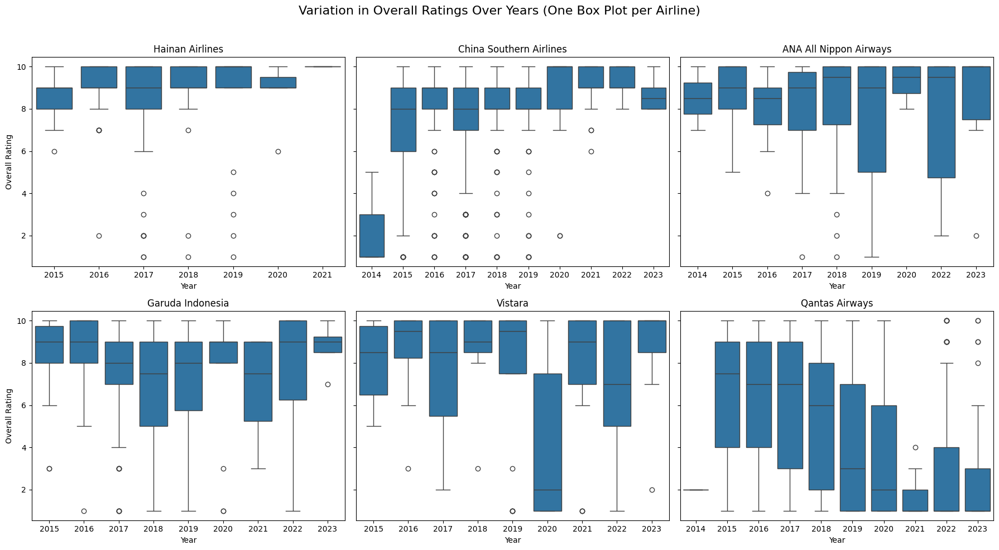

In [ ]:
import seaborn as sns

# Create 6 box plots (1 per airline)
fig, axs = pyplot.subplots(2, 3, figsize=(18, 10), sharey=True)
axs = axs.flatten()

# Iterate through each selected airline
for i, airline in enumerate(selected_airlines):
    airline_data = sample_df[(sample_df['AirlineName'] == airline) & (sample_df['Year'].notna())]
    sns.boxplot(data=airline_data, x='Year', y='OverallScore', ax=axs[i])
    axs[i].set_title(airline)
    axs[i].set_xlabel('Year')
    axs[i].set_ylabel('Overall Rating')

# Adjust layout
pyplot.suptitle('Variation in Overall Ratings Over Years (One Box Plot per Airline)', fontsize=16)
pyplot.tight_layout(rect=[0, 0, 1, 0.96])
pyplot.show()



Qantas Airways shows a clear decline in overall ratings over time, with both the median rating decreasing and the spread (variation) increasing—especially after 2018. In contrast, the top five-rated airlines (like Hainan Airlines, ANA, and EVA Air) tend to maintain consistently high median ratings with less fluctuation, indicating stronger and more stable passenger satisfaction. Qantas's wider interquartile range and more outliers in recent years suggest increased customer dissatisfaction or inconsistency in service delivery over time.

<a id = "cell_sentiment"></a>
### 3. Sentiment Analysis

**Aim:** To demonstrate your understanding in sentiment analysis.

_Use sentiment analysis to answer question (C) and (D)._

#### Lexicon-based Sentiment Analysis

In [ ]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

# Apply sentiment analysis to each review
sentiment_scores = sample_df['Review'].apply(sid.polarity_scores)

# Convert the sentiment scores (which are dicts) into separate columns
sentiment_df = sentiment_scores.apply(pd.Series)
sample_df = pd.concat([sample_df, sentiment_df], axis=1)

# Classify sentiment based on compound score
def classify_sentiment(score):
    if score > 0.2:
        return 'Positive'
    elif score < -0.2:
        return 'Negative'
    else:
        return 'Neutral'

# Apply function correctly
sample_df['SentimentLabel'] = sample_df['compound'].astype(float).apply(classify_sentiment)

# Show a sample of 10 reviews with all sentiment information
print(sample_df[['Review', 'compound', 'pos', 'neu', 'neg', 'SentimentLabel']].sample(10, random_state=1))

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


                                                  Review  compound    pos  \
17944  the seating in the front section of club world...    0.9790  0.176   
3769   on our way down to new zealand they lost our b...    0.7238  0.116   
24591  birmingham to bangkok via dubai excellent flig...    0.7849  0.175   
31545  iberia informed me by email that my flight was...   -0.2023  0.044   
68730  toronto to calgary i have never experienced su...    0.9459  0.064   
19437  british airways shorthaul economy product is f...    0.9335  0.171   
43355  kuala lumpur to london the airport was an abso...   -0.7814  0.055   
72714  ive been flying united airlines for most of my...    0.9881  0.184   
58312  minneapolis to ft myers i booked a flight to s...   -0.9879  0.046   
19761  singapore to seoul incheon via shanghai the pr...   -0.8915  0.033   

         neu    neg SentimentLabel  
17944  0.812  0.011       Positive  
3769   0.792  0.092       Positive  
24591  0.698  0.127       Positive  
3154

#### C. Compare the overall sentiments expressed by customers about airlines. Which airline received the most positive sentiments? ####

##### C1. Overall sentiments expressed by customers about airlines

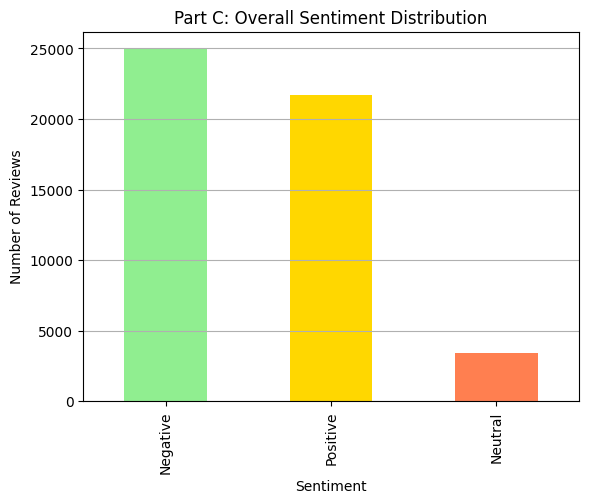

In [ ]:
# Display sentiment distribution
sample_df['SentimentLabel'].value_counts().plot(kind='bar', color=['lightgreen', 'gold', 'coral'])
plt.title('Part C: Overall Sentiment Distribution')
plt.xlabel('Sentiment')
plt.ylabel('Number of Reviews')
plt.grid(axis='y')
plt.show()

Part C - Airline with highest average sentiment: Hainan Airlines


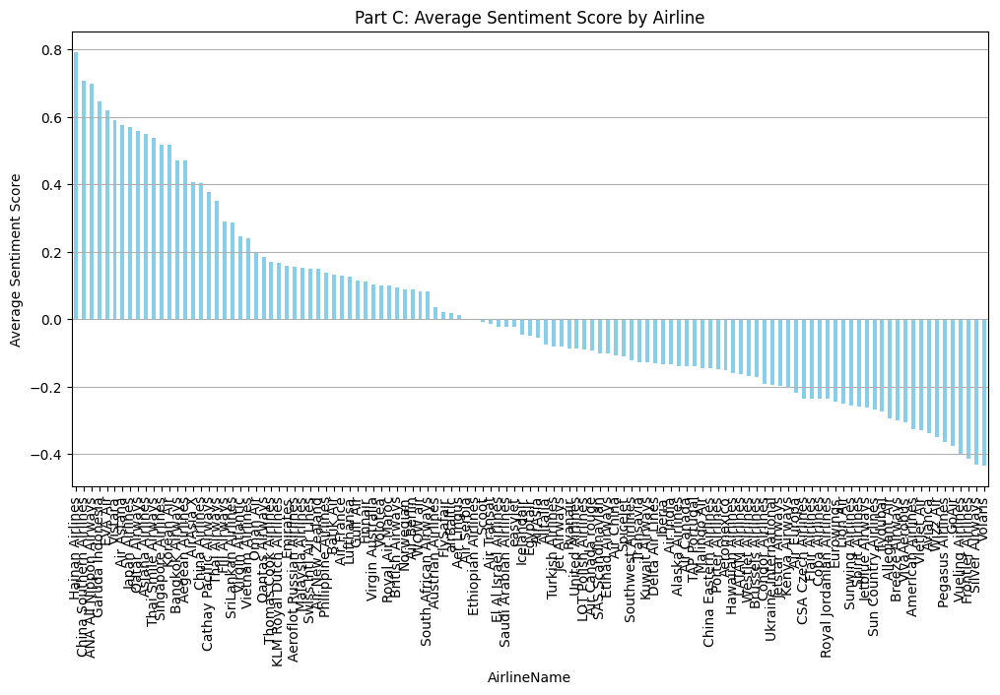

In [ ]:
# Average sentiment per airline
airline_avg_sentiment = sample_df.groupby('AirlineName')['compound'].mean().sort_values(ascending=False)
most_positive_airline = airline_avg_sentiment.idxmax()
print('Part C - Airline with highest average sentiment:', most_positive_airline)

# Plot average sentiment by airline
airline_avg_sentiment.plot(kind='bar', color='skyblue', figsize=(12, 6))
plt.title('Part C: Average Sentiment Score by Airline')
plt.ylabel('Average Sentiment Score')
plt.grid(axis='y')
plt.show()

##### C2. Which airlines received the most positive sentiments?

In [ ]:
# Sentiment counts and proportions
sentiment_counts = sample_df.groupby(['AirlineName', 'SentimentLabel']).size().unstack(fill_value=0)
sentiment_counts['TotalReviews'] = sentiment_counts.sum(axis=1)
sentiment_counts['PositiveRatio'] = sentiment_counts['Positive'] / sentiment_counts['TotalReviews']
sentiment_counts['NegativeRatio'] = sentiment_counts['Negative'] / sentiment_counts['TotalReviews']
sentiment_counts['NeutralRatio'] = sentiment_counts['Neutral'] / sentiment_counts['TotalReviews']


In [ ]:
# Rankings
positive_ranking = sentiment_counts.sort_values(by='Positive', ascending=False)
print("Airlines Ranked by Positive Review Count:")
print(positive_ranking[['Positive']])

positive_ratio_ranking = sentiment_counts.sort_values(by='PositiveRatio', ascending=False)
print("Airlines Ranked by Positive Review Proportion:")
print(positive_ratio_ranking[['PositiveRatio']])



Airlines Ranked by Positive Review Count:
SentimentLabel           Positive
AirlineName                      
Qatar Airways                 917
United Airlines               869
China Southern Airlines       863
British Airways               796
American Airlines             768
...                           ...
GoAir                          26
Silver Airways                 22
CSA Czech Airlines             21
Breeze Airways                 19
VivaAerobús                    19

[117 rows x 1 columns]
Airlines Ranked by Positive Review Proportion:
SentimentLabel           PositiveRatio
AirlineName                           
Hainan Airlines               0.920561
China Southern Airlines       0.880612
ANA All Nippon Airways        0.857988
Garuda Indonesia              0.835913
Air Astana                    0.812500
...                                ...
Vueling Airlines              0.213826
GoAir                         0.213115
Volaris                       0.207207
Frontier Airline

D. Identify the airline that received the most positive sentiment for their Economy class and Business
Class “service/s”.

In [ ]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import pandas as pd

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

# Function to detect aspect sentiment
def aspect_sentiment(text, aspect="service"):
    if pd.isna(text):
        return False
    tokens = word_tokenize(text.lower())
    if aspect not in ' '.join(tokens):
        return False
    score = sid.polarity_scores(text)
    return score['compound'] > 0.1  # classify as positive

# Apply aspect-level sentiment per review
sample_df['Is_Service_Positive'] = sample_df.apply(
    lambda row: aspect_sentiment(row['Review'], "service") if pd.notna(row['Review']) else False,
    axis=1
)

# Aggregate counts by airline and cabin type
service_summary = sample_df.groupby(['AirlineName', 'CabinType'])['Is_Service_Positive'].agg(
    positive_service_count='sum',
    total_reviews='size'
).reset_index()

# Filter for Economy and Business class
economy_service = service_summary[service_summary['CabinType'] == 'Economy Class']
business_service = service_summary[service_summary['CabinType'] == 'Business Class']

# Sort top airlines by positive service count
top_10_economy = economy_service.sort_values(by='positive_service_count', ascending=False).head(10)
top_10_business = business_service.sort_values(by='positive_service_count', ascending=False).head(10)

# Print results
print("Top 10 Airlines by Positive Service Reviews for Economy Class:")
print(top_10_economy[['AirlineName', 'positive_service_count', 'total_reviews']].to_string(index=False))

print("\nTop 10 Airlines by Positive Service Reviews for Business Class:")
print(top_10_business[['AirlineName', 'positive_service_count', 'total_reviews']].to_string(index=False))


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Top 10 Airlines by Positive Service Reviews for Economy Class:
            AirlineName  positive_service_count  total_reviews
          Qatar Airways                     319            728
China Southern Airlines                     317            695
        United Airlines                     316           2037
      American Airlines                     285           2800
        British Airways                     236           1011
        Spirit Airlines                     228           2622
               Emirates                     219            814
              Lufthansa                     195            746
        Delta Air Lines                     186           1252
     Singapore Airlines                     184            446

Top 10 Airlines by Positive Service Reviews for Business Class:
            AirlineName  positive_service_count  total_reviews
          Qatar Airways                     255            441
        British Airways                     181      

In [ ]:
# Calculate ratio
service_summary['positive_ratio'] = service_summary['positive_service_count'] / service_summary['total_reviews']

# Best by ratio
best_eco = service_summary[(service_summary['CabinType'] == 'Economy Class')].sort_values(by='positive_ratio', ascending=False).iloc[0]
best_bus = service_summary[(service_summary['CabinType'] == 'Business Class')].sort_values(by='positive_ratio', ascending=False).iloc[0]

print(f"Most Positive Airline for 'Service' in Economy Class: {best_eco['AirlineName']} ({best_eco['positive_ratio']:.2f})")
print(f"Most Positive Airline for 'Service' in Business Class: {best_bus['AirlineName']} ({best_bus['positive_ratio']:.2f})")


Most Positive Airline for 'Service' in Economy Class: ANA All Nippon Airways (0.53)
Most Positive Airline for 'Service' in Business Class: China Airlines (0.74)


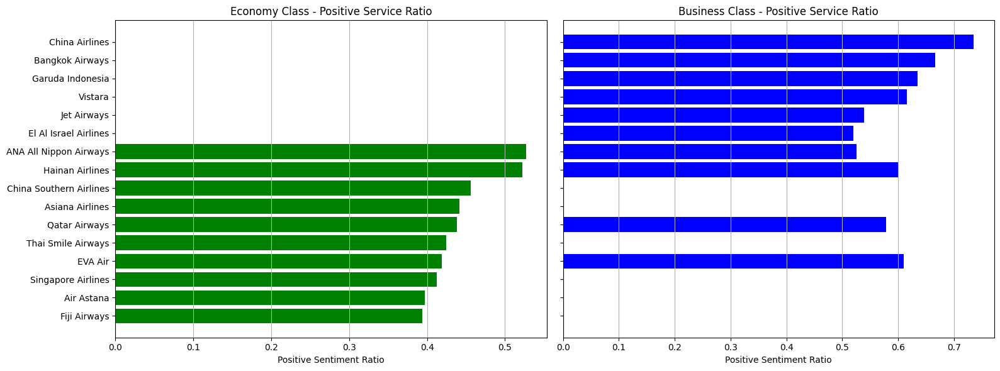

In [ ]:
import matplotlib.pyplot as plt

# Prepare the data
eco_plot = service_summary[service_summary['CabinType'] == 'Economy Class'].sort_values(by='positive_ratio', ascending=True).tail(10)
bus_plot = service_summary[service_summary['CabinType'] == 'Business Class'].sort_values(by='positive_ratio', ascending=True).tail(10)

# Create side-by-side bar charts
fig, axs = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

axs[0].barh(eco_plot['AirlineName'], eco_plot['positive_ratio'], color='green')
axs[0].set_title('Economy Class - Positive Service Ratio')
axs[0].set_xlabel('Positive Sentiment Ratio')
axs[0].invert_yaxis()
axs[0].grid(True, axis='x')

axs[1].barh(bus_plot['AirlineName'], bus_plot['positive_ratio'], color='blue')
axs[1].set_title('Business Class - Positive Service Ratio')
axs[1].set_xlabel('Positive Sentiment Ratio')
axs[1].invert_yaxis()
axs[1].grid(True, axis='x')

plt.tight_layout()
plt.show()


<a id = "cell_TopicModeling"></a>
### 4. Topic Modeling

**Aim:** To demonstrate your understanding in topic modeling.

_Use text-processing techniques to process and prepare textual data for topic modelling._

_Use LDA to explore topics discussed in the text reviews._

_Carry out experiments and demonstrate how an appropriate topic number is determined for your model._

_Interpret the discovered topics and answer question (E) and (F)._


#### Text Processing ####

In [ ]:
from nltk.stem import PorterStemmer
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

# Initialize stemmer and stop words
porter = PorterStemmer()
stop_words = set(stopwords.words('english'))

# Use your actual text column (here, assuming sample_df['Review'])
documents = sample_df['Review']
Cleaned_doc = []

for r in range(len(documents)):
    review = documents.iloc[r]  # ✅ FIXED here
    try:
        review = re.sub('[^A-Za-z]', ' ', review)
        review = review.lower()
        Tokens = review.split()
        Filtered_token = [w for w in Tokens if len(w) > 3]
        review = ' '.join(Filtered_token)
    except:
        continue
    Cleaned_doc.append(review)
    print('-[Review Text]:', review)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Streaming output truncated to the last 5000 lines.
-[Review Text]: worst airline ever they fleeced euros when tried checking night before website claimed couldnt without bags when show there they said check that will extra euros person they even charged year when said could check earlier site didnt allow without bags accounted they said thats your problem asked check online then there they said they wont done hours earlier what gamut what other airline does allow check online spot like costing them wages personnel most others even allow kegs this only gives they robbers thieves please this cheap airline with uncomfortable seats scalping practices
-[Review Text]: will never frontier again whats that this most friendly airlines cannot support their business will vocal friends about experiences this airlines broken flight time changed times were loaded plane only there without summer hours while waiting flight attendant mentioned engine broken dont this even doesnt effect flight just soun

In [ ]:
# STEP 2: Remove stopwords from Cleaned_doc
for r in range(len(Cleaned_doc)):
    each_item = []
    for t in Cleaned_doc[r].split():
        if t not in stop_words:
            each_item.append(t)
    Cleaned_doc[r] = ' '.join(each_item)
    print('-[Cleaned Text]:', Cleaned_doc[r])


Streaming output truncated to the last 5000 lines.
-[Cleaned Text]: worst airline ever fleeced euros tried checking night website claimed couldnt without bags show said check extra euros person even charged year said could check earlier site didnt allow without bags accounted said thats problem asked check online said wont done hours earlier gamut airline allow check online spot like costing wages personnel others even allow kegs gives robbers thieves please cheap airline uncomfortable seats scalping practices
-[Cleaned Text]: never frontier whats friendly airlines cannot support business vocal friends experiences airlines broken flight time changed times loaded plane without summer hours waiting flight attendant mentioned engine broken dont even doesnt effect flight sounds didnt enough fuel destination took hour fuel employees rude prompt reactive responses although baseline ticket prices cheap never worth experiences like every unless bring backpack seat want board early hope frontie

#### Latent Dirichlet Allocation ####

We use LDA (Latent Dirichlet Allocation) for parts E and F because it is a powerful unsupervised topic modeling technique that uncovers the underlying themes or topics within a collection of reviews.

##### Term Document Matrix #####

We use TDM to transform unstructured text reviews into structured data by reprensting the frequency of terms across documents
=> Identify pattern of word co-occurence, enable the extraction of laten topics discussed by passengers in their reviews.

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

count_vectorizer = CountVectorizer()# Fit and transform the processed titles

count_data = count_vectorizer.fit_transform(Cleaned_doc)
count_data

<Compressed Sparse Row sparse matrix of dtype 'int64'
	with 2651671 stored elements and shape (50000, 44386)>

Visualise the most common words

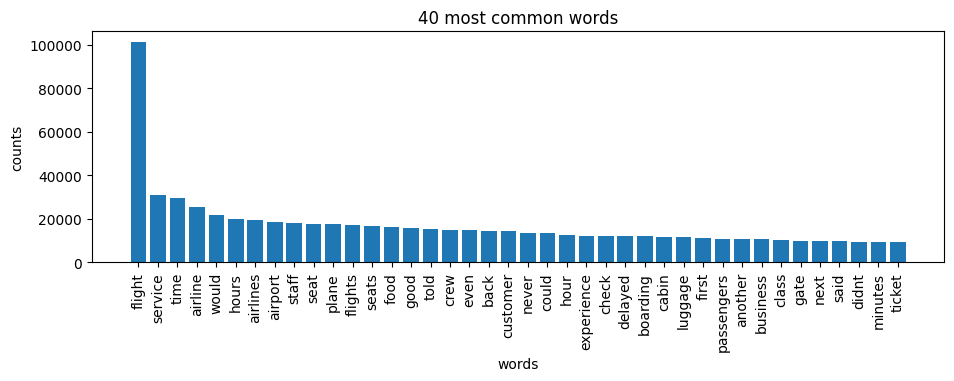

In [ ]:
import numpy as np

#Retrieve the words found by CountVectorizer
terms = count_vectorizer.get_feature_names_out()

# Count the popularity of words
# Create a NumPy array of zeroes to store total word counts, one for each word in terms
total_counts = np.zeros(len(terms))

#Sum the frequencies across all documents, loop through each document vector and adds up the words frequencies
for t in count_data:
    total_counts+=t.toarray()[0]

# zip function => pair the value in terms with the one in total count
count_dict = (zip(terms, total_counts))

#sort
count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:40] #Take the top 40 words


words = [w[0] for w in count_dict]
counts = [w[1] for w in count_dict]
x_pos = np.arange(len(words))

pyplot.figure(2, figsize=(11, 3))
pyplot.subplot(title='40 most common words')
pyplot.bar(words, counts)
pyplot.xticks(x_pos, words, rotation=90)
pyplot.xlabel('words')
pyplot.ylabel('counts')
pyplot.show()

In [ ]:
#Remove highly frequent (Greater than 20%) and infrequent words (less than 1%)
# % of the documents

keepIndex = [];
for t in range(len(total_counts)):
    if total_counts[t] < 10000 and total_counts[t] > 500:
        keepIndex.append(t)

print('Number of Terms Remained: ', len(keepIndex))

#Save the remain ing term and frequency data
ReducedTerm = [terms[t] for t in keepIndex] #only the terms that passed the frequency filter
ReducedCount = count_data[:,keepIndex]
ReducedCount

Number of Terms Remained:  1059


<Compressed Sparse Row sparse matrix of dtype 'int64'
	with 1584435 stored elements and shape (50000, 1059)>

##### LDA Modeling #####

In [ ]:
from sklearn.decomposition import LatentDirichletAllocation as LDA

# Tweak the two parameters below
number_topics = 5

lda = LDA(n_components=number_topics, n_jobs=-1, random_state=2023)
#n_components=number_topics: set the num of topics LDA discover
#n_jobs=-1: CPU cores to use during training => -1: all available cores

lda.fit(ReducedCount)
#Trained LDA model
lda.components_ #each row represents a topic and contains the unormalised word distribution.


array([[3.56863676e+02, 1.44034188e+01, 1.18745304e+02, ...,
        4.29549605e+01, 1.13286194e+00, 6.09801100e+01],
       [4.47192225e+02, 4.01283074e+01, 5.84560153e+01, ...,
        7.68071771e+01, 2.39831724e+01, 5.30689906e+02],
       [1.77329876e+03, 2.00863589e+02, 6.55298739e+02, ...,
        9.57386716e+01, 3.23871104e+02, 2.15406810e+01],
       [1.11280848e+03, 1.59799734e+02, 4.09748972e+02, ...,
        6.33325383e+01, 2.24496984e+02, 1.87585957e+02],
       [5.56836863e+02, 3.13804950e+02, 1.07675097e+03, ...,
        6.83166652e+02, 3.60515877e+02, 2.03345634e-01]])

In [ ]:
lda.components_.shape

(5, 1059)

<a id = "cell_WordProbabilities"></a>
#####  Word Probabilities by Topic

In [ ]:
Word_Topics_Pro = lda.components_ / lda.components_.sum(axis=1)[:, np.newaxis]
print(Word_Topics_Pro)

[[1.28145490e-03 5.17209591e-05 4.26400223e-04 ... 1.54246140e-04
  4.06797211e-06 2.18972302e-04]
 [1.25221107e-03 1.12365797e-04 1.63686365e-04 ... 2.15072607e-04
  6.71567893e-05 1.48601818e-03]
 [3.76894180e-03 4.26912371e-04 1.39276182e-03 ... 2.03481494e-04
  6.88350643e-04 4.57822308e-05]
 [2.58098408e-03 3.70630327e-04 9.50348237e-04 ... 1.46889853e-04
  5.20685414e-04 4.35076097e-04]
 [1.53533103e-03 8.65234524e-04 2.96885729e-03 ... 1.88365216e-03
  9.94027607e-04 5.60672044e-07]]


In [ ]:
for topic_idx, topic in enumerate(Word_Topics_Pro):
    print("\nTopic #%d:" % topic_idx)
    count_dict = (zip(ReducedTerm, topic))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:5]
    for w in count_dict:
        print(w[0], ': {0:.3f}'.format(w[1]))


Topic #0:
great : 0.016
entertainment : 0.015
comfortable : 0.014
friendly : 0.012
excellent : 0.010

Topic #1:
meal : 0.015
economy : 0.010
served : 0.010
drinks : 0.009
lounge : 0.009

Topic #2:
cancelled : 0.014
refund : 0.013
ticket : 0.013
days : 0.012
call : 0.011

Topic #3:
gate : 0.020
minutes : 0.015
delay : 0.011
said : 0.011
next : 0.010

Topic #4:
dont : 0.012
worst : 0.011
united : 0.011
flying : 0.011
spirit : 0.010


In [ ]:
# View full Word Probabilities by Topic Matrix
df_topic_keywords = pd.DataFrame(Word_Topics_Pro)
df_topic_keywords.columns = ReducedTerm
df_topic_keywords

,able,absolute,absolutely,accept,acceptable,access,accommodation,account,across,actually,...,wouldnt,write,wrong,year,years,york,young,youre,zero,zurich
0,0.001281,0.000052,0.000426,8.559740e-07,0.000569,0.000562,4.155969e-05,0.000016,0.000361,0.000574,...,0.000147,0.000264,0.000099,0.001489,0.002626,0.002047,0.000492,0.000154,0.000004,2.189723e-04
1,0.001252,0.000112,0.000164,1.437374e-04,0.000952,0.001740,5.880205e-06,0.000083,0.000672,0.001151,...,0.000332,0.000105,0.000278,0.000771,0.001792,0.000494,0.000192,0.000215,0.000067,1.486018e-03
2,0.003769,0.000427,0.001393,8.403086e-04,0.000275,0.000273,8.538471e-04,0.001087,0.000123,0.001301,...,0.001060,0.000383,0.001273,0.001817,0.000768,0.000689,0.000062,0.000203,0.000688,4.578223e-05
3,0.002581,0.000371,0.000950,2.329130e-04,0.000161,0.000343,4.949103e-04,0.000005,0.000563,0.001020,...,0.001355,0.000223,0.001570,0.000525,0.000628,0.000890,0.000818,0.000147,0.000521,4.350761e-04
4,0.001535,0.000865,0.002969,2.471589e-04,0.000117,0.000021,5.646517e-07,0.000095,0.000481,0.001726,...,0.002053,0.000529,0.000824,0.002624,0.003150,0.001378,0.000258,0.001884,0.000994,5.606720e-07


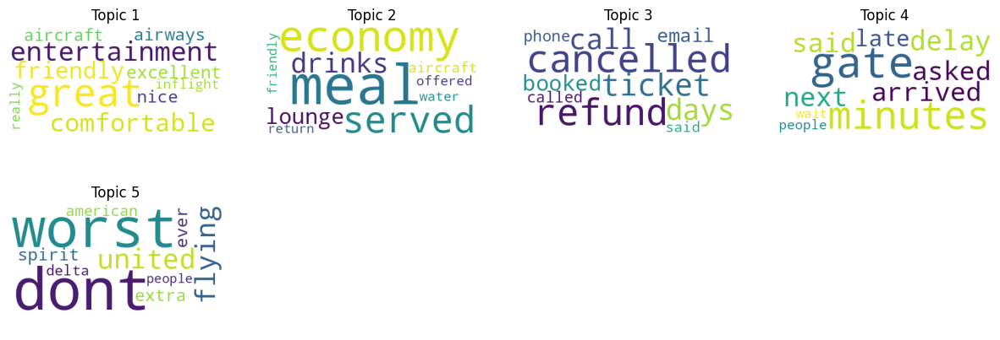

In [ ]:
#!pip install wordcloud

from wordcloud import WordCloud
import math
rows = math.ceil(len(Word_Topics_Pro)/4)
fig, ax = pyplot.subplots(rows, 4, figsize=(15,2.5*rows))
[axi.set_axis_off() for axi in ax.ravel()]
for topic_idx, topic in enumerate(Word_Topics_Pro):
    count_dict = (zip(ReducedTerm, topic))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)

    # convert to dictionary type - keep top 10 words
    Word_Frequency = dict(count_dict[0:10])
    # generate word cloud
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(Word_Frequency)
    # visualize word cloud in figure
    subfig_Row = math.floor(topic_idx/4)
    subfig_Col = math.ceil(topic_idx%4)
    ax[subfig_Row,subfig_Col].imshow(wordcloud)
    ax[subfig_Row,subfig_Col].set_title("Topic {}".format(topic_idx+1))
pyplot.show()

In [ ]:
#Compute topic distribution for each document
TopicDis_Doc = lda.transform(ReducedCount)

#each row represent one document
#numbers in each row represent distribution of topics of that docs

#Compute overall topic distribution for all each documents
Overall_Topic_Dis = sum(TopicDis_Doc)/sum(sum(TopicDis_Doc))
Overall_Topic_Dis

array([0.18474569, 0.1906816 , 0.21509557, 0.19820513, 0.21127201])

/tmp/ipython-input-3678760577.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  pyplot.legend()


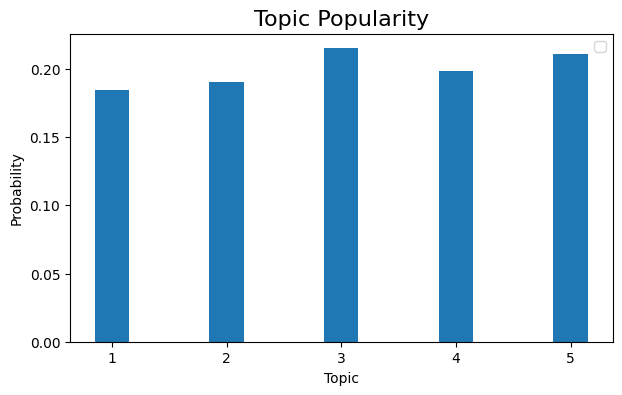

In [ ]:
# Get the topic index
Bar_index = np.asarray(range(1,number_topics+1))

#Visualize topic distributions of review groups
pyplot.figure(figsize=(7,4))
pyplot.title('Topic Popularity', fontsize=16)
pyplot.xlabel('Topic')
pyplot.ylabel('Probability')
pyplot.bar(Bar_index, Overall_Topic_Dis.tolist(), 0.3)
pyplot.xticks(Bar_index, Bar_index)
pyplot.legend()
pyplot.show();

In [ ]:
# View full Topic Probabilities by Document Matrix
TopicDis_Doc = lda.transform(ReducedCount)
df_document_topics = pd.DataFrame(TopicDis_Doc)
df_document_topics

,0,1,2,3,4
0,0.006379,0.631635,0.178483,0.006418,0.177084
1,0.007289,0.530114,0.226781,0.228485,0.007331
2,0.880295,0.011288,0.011349,0.011206,0.085862
3,0.897123,0.025782,0.025842,0.025302,0.025951
4,0.013577,0.945713,0.013556,0.013549,0.013606
...,...,...,...,...,...
49995,0.009871,0.201203,0.009859,0.769308,0.009758
49996,0.003194,0.003195,0.062214,0.548126,0.383271
49997,0.004311,0.004306,0.509090,0.004329,0.477964
49998,0.007879,0.007898,0.156011,0.007787,0.820424


<a id = "cell_TopicProbabilitiesDocument"></a>
#####  Topic Probabilities by Document

In [ ]:
TopicDis_Doc = lda.transform(ReducedCount)
df_document_topics = pd.DataFrame(TopicDis_Doc)
df_document_topics

,0,1,2,3,4
0,0.006379,0.631635,0.178483,0.006418,0.177084
1,0.007289,0.530114,0.226781,0.228485,0.007331
2,0.880295,0.011288,0.011349,0.011206,0.085862
3,0.897123,0.025782,0.025842,0.025302,0.025951
4,0.013577,0.945713,0.013556,0.013549,0.013606
...,...,...,...,...,...
49995,0.009871,0.201203,0.009859,0.769308,0.009758
49996,0.003194,0.003195,0.062214,0.548126,0.383271
49997,0.004311,0.004306,0.509090,0.004329,0.477964
49998,0.007879,0.007898,0.156011,0.007787,0.820424


Topic Probablity distribution by Document: 
 [[0.00637906 0.63163549 0.17848319 0.00641839 0.17708387]
 [0.00728852 0.53011437 0.226781   0.2284851  0.00733101]
 [0.88029514 0.01128763 0.0113487  0.01120646 0.08586207]
 [0.89712319 0.02578224 0.02584201 0.02530155 0.02595102]
 [0.01357664 0.94571335 0.01355567 0.01354875 0.01360559]]


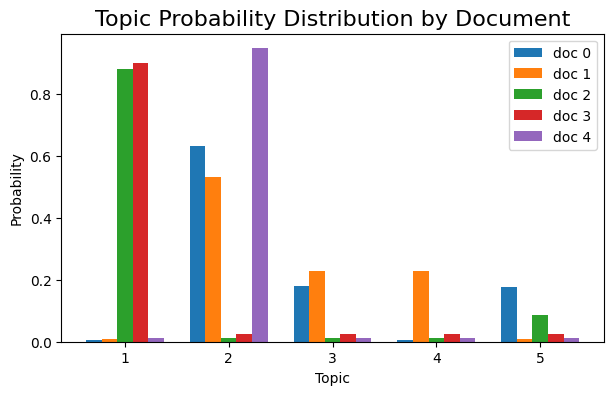

In [ ]:
# Compute the topic distribution for some reviews:
TopicDis_Doc = TopicDis_Doc[0:5]
print('Topic Probablity distribution by Document: \n', TopicDis_Doc)
# Get the topic index
Bar_index = np.asarray(range(1,number_topics+1))

#Create a new figure
pyplot.figure(figsize=(7,4))
pyplot.title('Topic Probability Distribution by Document', fontsize=16)
pyplot.xlabel('Topic')
pyplot.ylabel('Probability')

width = 0.15
for i in range(0,5):
    pyplot.bar(Bar_index + i*width, TopicDis_Doc[i].tolist(), width,  label='doc ' + str(i))

pyplot.xticks(Bar_index + 2*width, Bar_index)
pyplot.legend()
pyplot.show();

<a id = "cell_TopicProbabilitiesGroup"></a>
#####  Topic Probabilities by Document Group

Business managers are often interesting in idendifying topics, which are frequrently mentioned by specific groups of reviewers. We can compute the probablity distribution with respect to document groups by normalizing the probablities of topics over multiple documents in a group. For demonstration, we compute and display the topic probability distributions of documents, which were written by reviewers from United Kindom:

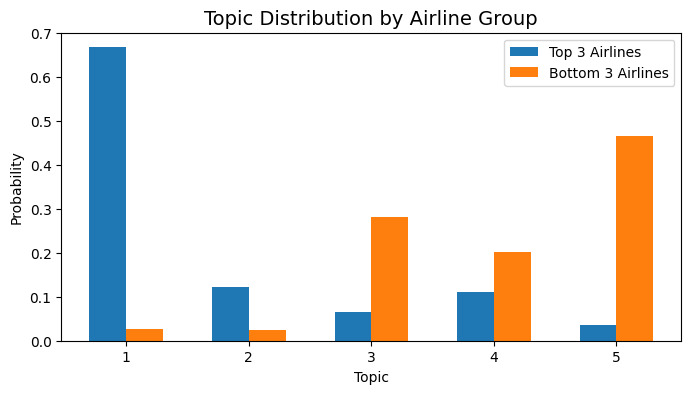

In [ ]:
import numpy as np
from matplotlib import pyplot

# Define top and bottom 3 airlines
top_airlines = ['Hainan Airlines', 'China Southern Airlines', 'ANA All Nippon Airways']
bottom_airlines = ['Volaris', 'Frontier Airlines', 'Silver Airways']  # Replace this with real names

# Filter review matrices
TopGroup = ReducedCount[np.where(sample_df['AirlineName'].isin(top_airlines))]
BottomGroup = ReducedCount[np.where(sample_df['AirlineName'].isin(bottom_airlines))]

# Compute topic distributions
TopicDis_Top = lda.transform(TopGroup)
TopicDis_Bottom = lda.transform(BottomGroup)

# Normalize distributions
Group_Topic_Top = sum(TopicDis_Top) / sum(sum(TopicDis_Top))
Group_Topic_Bottom = sum(TopicDis_Bottom) / sum(sum(TopicDis_Bottom))

# Plot
Bar_index = np.arange(1, len(Group_Topic_Top) + 1)

pyplot.figure(figsize=(8, 4))
pyplot.title('Topic Distribution by Airline Group', fontsize=14)
pyplot.xlabel('Topic')
pyplot.ylabel('Probability')
pyplot.bar(Bar_index - 0.15, Group_Topic_Top.tolist(), width=0.3, label='Top 3 Airlines')
pyplot.bar(Bar_index + 0.15, Group_Topic_Bottom.tolist(), width=0.3, label='Bottom 3 Airlines')
pyplot.xticks(Bar_index)
pyplot.legend()
pyplot.show()


<a id = "cell_Selecting"></a>
#####  Selecting Topic Number

In [ ]:
!pip install Cython
!pip install gensim

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 62.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 78.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 17.9 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.0
    Uninstalling scipy-1.16.0:
      Successfully uninstalled scipy-1.16.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opencv-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
openc

In [ ]:
Cleaned_doc_new = []
print('CLEANED TEXT NEW: ')
for r in range(len(Cleaned_doc)):
    each_item = []
    for t in Cleaned_doc[r].split():
        #Keep only terms included in ReducedTerm
        if t in ReducedTerm:
             each_item.append(t)
    Cleaned_doc_new.append(each_item)
    print(Cleaned_doc_new[r])

Streaming output truncated to the last 5000 lines.
['worst', 'ever', 'euros', 'tried', 'checking', 'night', 'website', 'couldnt', 'without', 'bags', 'show', 'said', 'extra', 'euros', 'person', 'charged', 'year', 'said', 'earlier', 'site', 'didnt', 'allow', 'without', 'bags', 'said', 'thats', 'problem', 'asked', 'online', 'said', 'wont', 'done', 'earlier', 'allow', 'online', 'like', 'personnel', 'others', 'allow', 'please', 'cheap', 'uncomfortable']
['frontier', 'friendly', 'cannot', 'support', 'friends', 'experiences', 'broken', 'changed', 'times', 'without', 'waiting', 'attendant', 'mentioned', 'broken', 'dont', 'doesnt', 'didnt', 'enough', 'destination', 'took', 'employees', 'rude', 'although', 'ticket', 'prices', 'cheap', 'worth', 'experiences', 'like', 'every', 'unless', 'bring', 'want', 'board', 'early', 'hope', 'frontier', 'access', 'friendly', 'change', 'dont', 'frontier', 'especially', 'youre', 'vacation', 'worth', 'start', 'vacation', 'costs', 'better']
['traveling', 'family',

In [ ]:
import gensim.corpora as corpora

# Construct term dictionary in the format "Term : Index"
id2word = corpora.Dictionary(Cleaned_doc_new)
print(id2word.token2id)

{'able': 0, 'absolutely': 1, 'area': 2, 'avoid': 3, 'aware': 4, 'board': 5, 'booking': 6, 'early': 7, 'free': 8, 'late': 9, 'like': 10, 'march': 11, 'meal': 12, 'often': 13, 'online': 14, 'ordered': 15, 'possible': 16, 'pretty': 17, 'read': 18, 'singapore': 19, 'small': 20, 'special': 21, 'surprise': 22, 'talk': 23, 'tasty': 24, 'thats': 25, 'therefore': 26, 'theyre': 27, 'three': 28, 'usual': 29, 'actually': 30, 'april': 31, 'called': 32, 'cold': 33, 'coming': 34, 'different': 35, 'difficult': 36, 'door': 37, 'exit': 38, 'left': 39, 'legroom': 40, 'might': 41, 'morning': 42, 'next': 43, 'packed': 44, 'people': 45, 'reservation': 46, 'side': 47, 'sleep': 48, 'theres': 49, 'took': 50, 'zurich': 51, 'comfortable': 52, 'costs': 53, 'extremely': 54, 'france': 55, 'frankfurt': 56, 'great': 57, 'ground': 58, 'lounge': 59, 'lufthansa': 60, 'nice': 61, 'overall': 62, 'polite': 63, 'recommend': 64, 'spacious': 65, 'traveling': 66, 'aircraft': 67, 'although': 68, 'meals': 69, 'money': 70, 'value

In [ ]:
#Bag of Word Representation
Corpus = [id2word.doc2bow(text) for text in Cleaned_doc_new]
print(Corpus)

[[(0, 2), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 1), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1)], [(6, 1), (7, 1), (13, 2), (19, 1), (30, 1), (31, 1), (32, 1), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 1), (39, 1), (40, 1), (41, 1), (42, 1), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1)], [(52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 2), (58, 1), (59, 1), (60, 2), (61, 1), (62, 1), (63, 1), (64, 1), (65, 1), (66, 1)], [(5, 1), (63, 1), (67, 1), (68, 1), (69, 1), (70, 1), (71, 1)], [(72, 1), (73, 1), (74, 1), (75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 2), (81, 1), (82, 1), (83, 1), (84, 1)], [(10, 1), (14, 1), (27, 1), (47, 1), (64, 1), (69, 1), (73, 1), (85, 1), (86, 1), (87, 1), (88, 1), (89, 1), (90, 1), (91, 1), (92, 1), (93, 1), (94, 1), (95, 1), (96, 1), (97, 1), (9

In [ ]:
import gensim
from gensim.models.ldamodel import LdaModel
from pprint import pprint#

#Train model using bag of word reprentation
lda_model = gensim.models.ldamodel.LdaModel(corpus=Corpus,
                                       id2word=id2word,
                                       num_topics=10,
                                       random_state=100)

#Print the Keyword in the 10 topics
pprint(lda_model.print_topics(num_words=10))
doc_lda = lda_model[Corpus]

[(0,
  '0.026*"lounge" + 0.021*"qatar" + 0.019*"airways" + 0.016*"doha" + '
  '0.015*"checkin" + 0.011*"aircraft" + 0.011*"meal" + 0.009*"ground" + '
  '0.008*"drinks" + 0.008*"kuala"'),
 (1,
  '0.024*"ticket" + 0.014*"paid" + 0.012*"refund" + 0.012*"change" + '
  '0.012*"money" + 0.012*"tickets" + 0.011*"extra" + 0.011*"booked" + '
  '0.011*"covid" + 0.011*"online"'),
 (2,
  '0.074*"canada" + 0.050*"toronto" + 0.047*"lufthansa" + 0.037*"turkish" + '
  '0.033*"istanbul" + 0.028*"frankfurt" + 0.024*"vancouver" + 0.024*"paris" + '
  '0.019*"france" + 0.017*"montreal"'),
 (3,
  '0.016*"cancelled" + 0.014*"days" + 0.013*"next" + 0.013*"call" + '
  '0.012*"hotel" + 0.011*"said" + 0.010*"refund" + 0.010*"help" + '
  '0.010*"later" + 0.009*"phone"'),
 (4,
  '0.015*"asked" + 0.013*"didnt" + 0.013*"like" + 0.013*"said" + '
  '0.012*"people" + 0.011*"dont" + 0.011*"rude" + 0.011*"water" + '
  '0.010*"attendant" + 0.009*"worst"'),
 (5,
  '0.029*"india" + 0.028*"lisbon" + 0.027*"delhi" + 0.025*"ai

In [ ]:
from gensim.models import CoherenceModel

# Compute Coherence Score. Note: that CoherenceModel require
# text input format (Cleaned_doc_new) instead of bag of word
coherence_model_lda = CoherenceModel(model=lda_model,
                                     texts=Cleaned_doc_new,
                                     dictionary=id2word,
                                     coherence='c_v')


coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Coherence Score:  0.5228303504384526


In [ ]:
#Evaluation models with topics numbers from 2 to 10
Topics = list(range(2,11,1))
coherence_scores = []
Trained_Models = []
for top in Topics:
    lda_model = gensim.models.ldamodel.LdaModel(corpus=Corpus,
                                               id2word=id2word,
                                               num_topics=top,
                                               random_state=100)
    #Keep the trained models
    Trained_Models.append(lda_model)
    #Compute coherence score for each model
    coherence_model_lda = CoherenceModel(model=lda_model,
                                         texts=Cleaned_doc_new,
                                         dictionary=id2word,
                                         coherence='c_v')
    coherence = coherence_model_lda.get_coherence()
    #Save and print the coherence scores
    coherence_scores.append(coherence)
    print('Topic Number: {0} -- Coherence: {1}'.format(top, coherence))

Topic Number: 2 -- Coherence: 0.5967364912687421
Topic Number: 3 -- Coherence: 0.5241287575996812
Topic Number: 4 -- Coherence: 0.5802880137452316
Topic Number: 5 -- Coherence: 0.6050576010442098
Topic Number: 6 -- Coherence: 0.569232892705688
Topic Number: 7 -- Coherence: 0.5362358682936424
Topic Number: 8 -- Coherence: 0.5588685383766003
Topic Number: 9 -- Coherence: 0.5336547450583926
Topic Number: 10 -- Coherence: 0.5228303504384526


Text(0, 0.5, 'Coherence')

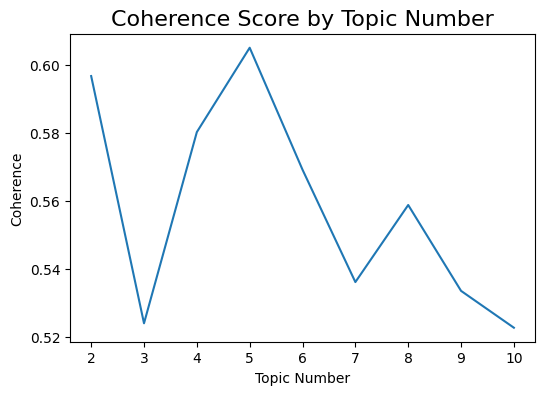

In [ ]:
 pyplot.figure(figsize=(6,4))
 pyplot.plot(coherence_scores)
 pyplot.xticks(range(0,len(Topics)),Topics)
 pyplot.title('Coherence Score by Topic Number', fontsize=16)
 pyplot.xlabel('Topic Number')
 pyplot.ylabel('Coherence')

In [ ]:
import numpy
lda_model = Trained_Models[numpy.argmax(coherence_scores)]

#Show top 10 words in each topic
lda_model.show_topics(num_words=10)

[(0,
  '0.016*"meal" + 0.012*"lounge" + 0.012*"economy" + 0.010*"airways" + 0.010*"served" + 0.009*"singapore" + 0.008*"aircraft" + 0.008*"qatar" + 0.008*"qantas" + 0.008*"drinks"'),
 (1,
  '0.017*"ticket" + 0.016*"refund" + 0.011*"money" + 0.010*"booked" + 0.009*"paid" + 0.009*"call" + 0.009*"tickets" + 0.008*"change" + 0.008*"email" + 0.008*"online"'),
 (2,
  '0.016*"friendly" + 0.016*"great" + 0.013*"comfortable" + 0.013*"lufthansa" + 0.013*"nice" + 0.009*"really" + 0.009*"entertainment" + 0.009*"aircraft" + 0.009*"helpful" + 0.009*"well"'),
 (3,
  '0.012*"next" + 0.012*"gate" + 0.010*"hotel" + 0.010*"minutes" + 0.008*"said" + 0.008*"cancelled" + 0.008*"delay" + 0.008*"help" + 0.008*"wait" + 0.008*"arrived"'),
 (4,
  '0.012*"people" + 0.012*"worst" + 0.011*"like" + 0.011*"dont" + 0.010*"rude" + 0.010*"ever" + 0.009*"didnt" + 0.009*"asked" + 0.009*"flying" + 0.008*"said"')]

Question E: What are the concerns and interests of passengers when flying with an airline?
Topic modeling of customer reviews reveals a variety of concerns and interests shared by passengers. Key recurring themes include:

Service quality: Words like “friendly,” “great,” “entertainment,” “comfortable” indicate that passengers value attentive crew, comfort, and in-flight amenities.

Flight delays and cancellations: Topics with terms like “cancelled,” “refund,” “call,” “email,” “delay,” “gate,” “arrived” suggest significant concern over operational reliability and communication during disruptions.

Check-in and boarding experiences: Frequent mentions of “gate,” “minutes,” “asked,” “said,” reflect frustrations or experiences during boarding.

Food and seating: Terms such as “meal,” “served,” “economy,” “aircraft,” “drinks” show that food quality and seating arrangements are of interest.

Overall, passengers are focused on service experience, punctuality, and comfort during the flight journey.

Question F: What are the differences in concerns and interests between passengers flying on the top three-rated airlines and the bottom three-rated airlines? Explain potential reasons for these differences.
Analysis of topic distributions shows clear contrasts between top and bottom-rated airlines:

For the top 3 airlines (e.g., Hainan Airlines, China Southern, ANA), over 55% of the content is linked to positive themes like “comfortable,” “friendly,” “entertainment,” “great”. Passengers flying these airlines emphasize high-quality service, professionalism, and comfort.

For the bottom 3 airlines (e.g., Volaris, Frontier, Silver Airways), reviews are dominated by negative topics—“cancelled,” “refund,” “gate,” “delayed,” “worst,” “dont”—making up more than 60% of their review content. These passengers express frustration with poor reliability, lack of support, and bad experiences.

Reasons for the differences likely stem from operational quality: top airlines provide consistent, premium service, while the bottom airlines struggle with delays, cancellations, and inadequate customer service—resulting in greater passenger dissatisfaction.



<a id = "cell_GensimLDA"></a>
#####  Gensim LDA Model

<a id = "cell_Practicalimplication"></a>
### 5. Practical Implication

**Aim:** To apply analytics result in addressing practical business problems.



### References:

_List references to other materials that you used for this assignment here_